<h1 align="center">Problem 2 - Practical HBM</h1>
<h2 align="center">One- and Two-Component Gaussian Mixture Hierarchcial Bayesian Modeling with PyJAGS</h2>
<h3 align="center">Simulating the eccentricity distribution of hot Jupiter exoplanets from the Kepler Mission</h3> 
<h4 align="center">LSSTC DSFP Session 4, September 21st, 2017</h4>
<h5 align="center">Author: Megan I. Shabram, PhD, 
NASA Postdoctoral Program Fellow,  mshabram@gmail.com</h5>


1. Use the code below to explore a two-component Gaussian mixture model
2. Using the simulated data code cells below, evaluate the one-component truncated Gaussian generative model simualted data with the two-component Gaussian mixture HBM. What do you notice about the posteriors for the mixture fractions? 
3. Repeat this exersize but now evaluating simulated data from a one-component generative model with a two-component HBM. 
4. Notebook 3: Using the JAGS model code block for a break-point HBM, set up and evaluate the break-point HBM on the real Kepler eclipsing binary data set provided (some code is provided for analysis).  



In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pyjags
import pickle

from __future__ import division, print_function
from pandas.tools.plotting import *
from matplotlib import rcParams
rcParams["savefig.dpi"] = 100
rcParams["font.size"] = 20
#plt.style.use('ggplot')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#%qtconsole


<h3 align="left"> 1. Generate simulated data set: one- and two-component truncated Gaussian mixture generative models:</h3>


In [12]:
## function to draw from truncated normal, this function will be used for both the 
## one- and two-componenet cases in this workbook.  

def rnorm_bound( Ndata, mu, prec, lower_bound = 0.0, upper_bound = float('Inf')):
    x = np.zeros(Ndata)
    #print(x)
    for i in range(0, Ndata): 
            #print(i)
            while True:
                x[i] = np.random.normal(mu,prec,1)
                if( (x[i]>lower_bound) and (x[i]<upper_bound) ): 
                    break
    return x;

In [13]:
## Check the output to make sure the function is outputting as expected. 
#print(np.random.normal(0,0.0001,10))
print(rnorm_bound(10, 0.0, 0.001, lower_bound=-1,upper_bound=1))

[  2.97238353e-04  -7.07909828e-04  -3.70512172e-04   5.88155038e-05
   5.76627068e-04   1.20332564e-03   6.26880627e-04  -1.08642308e-03
   2.96535185e-04   6.24871571e-05]


[ -3.40493094e-01  -4.97673300e-01   6.32905786e-02  -1.48369826e-01
  -2.94989896e-01   5.61517750e-01   4.69328633e-01  -1.54617219e-01
   3.34577042e-01  -2.53395339e-01  -1.50336187e-01   6.79048212e-01
   4.31269606e-01  -2.96792467e-02   3.96491168e-01   6.70952338e-05
  -1.73811393e-01   4.14366486e-01  -1.30318688e-01   3.19738351e-01
  -2.56580375e-01   2.03932435e-01   7.08949862e-01   2.67813739e-01
  -2.77139456e-01] [-0.36295248 -0.50804868 -0.00393815 -0.10090406 -0.35517848  0.58626295
  0.44000239 -0.08995457  0.32607376 -0.25358944 -0.13295415  0.75303413
  0.42791868  0.00376717  0.40571807 -0.03397394 -0.21739642  0.38187715
 -0.16719552  0.33255616 -0.19152733  0.16574676  0.74864377  0.27334454
 -0.23907139] [-0.24800389 -0.71723925  0.17633094  0.04306773 -0.05355934  0.0241382
  0.29846281 -0.08825147 -0.12546246 -0.06857637  0.52127248  0.43669513
 -0.09140128  0.20117769  0.55193471 -0.14501751  0.05093345 -0.3030341
  0.32685636 -0.00870975 -0.13366482 -0.0901

(array([ 1.,  2.,  6.,  4.,  1.,  1.,  3.,  4.,  1.,  2.]),
 array([-0.50804868, -0.3819404 , -0.25583212, -0.12972383, -0.00361555,
         0.12249273,  0.24860101,  0.37470929,  0.50081757,  0.62692585,
         0.75303413]),
 <a list of 10 Patch objects>)

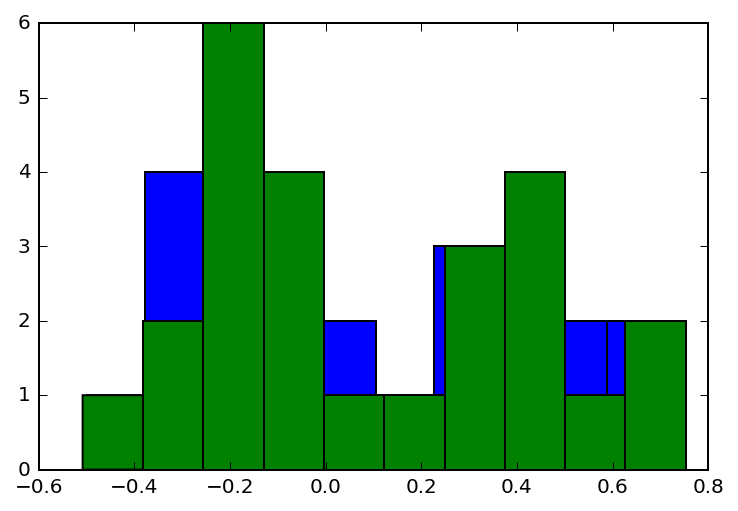

In [14]:
## One-component Gaussian Mixture Simulated Data for both projected eccentricity terms
## Below we designate the population values of our generative model. These are the 
## truths that we should recover if our hiararchical Bayesian model is properly specified 
## and diagnostics have indicated that the simulation has "not not converged". "You can't 
## prove convergence, at best you can fail to prove a failure to converge".

## In this simulated data set, their are 25 planetary systems (with one planet each)
Ndata = 25 
## Here we asign the dispersion of the simulated population to be 0.3, this is 
## the truth we wish to recovern 
sigmae = 0.3 
## We approximate the uncertainty for each measurement as normally distributed about a 
## reporte measurement point estimate.  
## For the eccentricity distribution for Hot Jupiters, the physical models used to derive 
## these produce larger uncertainty in k by a factor of 2. 
sigmahobs = 0.04
sigmakobs = 0.08

h = np.repeat(0.,Ndata)
k = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
khat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)
khat_sigma  = np.repeat(sigmakobs,Ndata)

#print(khat_sigma)


for i in range(0,Ndata):
    h[i] = rnorm_bound(1,0,sigmae,lower_bound=-1,upper_bound=1)
    lb = -np.sqrt(1-h[i]**2)
    ub = np.sqrt(1-h[i]**2)
    k[i] = rnorm_bound(1,0,sigmae,lower_bound=lb,upper_bound=ub) 
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)
    khat[i] = rnorm_bound(1,k[i],sigmakobs,lower_bound=lb,upper_bound=ub)

## Vizualize the true data values, and the simulated measurements:     
print(h, hhat, k, khat)
plt.hist(h)
plt.hist(hhat)

In [16]:
## JAGS user manual: 
## http://www.uvm.edu/~bbeckage/Teaching/DataAnalysis/Manuals/manual.jags.pdf

## JAGS model code

## model code is the one-component truncated gaussian mixture HBM code from previous 
## notebook


code1 = '''

model {
        
    #Population parameters
    e_sigma ~ dunif(0.0, 1.0)
    e_phi <- 1/(e_sigma*e_sigma)
        
    for (n in 1:Ndata){
    
        #True planet properties
        h[n] ~ dnorm(0, e_phi) T(-1,1) #Can try multivariate truncated normal in future
        k[n] ~ dnorm(0, e_phi) T(-sqrt(1-h[n]*h[n]),sqrt(1-h[n]*h[n]))
            
        #Observed planet properties
        hhat[n] ~ dnorm(h[n], 1.0/(hhat_sigma[n]*hhat_sigma[n])) T(-1,1)
        khat[n] ~ dnorm(k[n], 1.0/(khat_sigma[n]*khat_sigma[n])) T(-sqrt(1-hhat[n]*hhat[n]),sqrt(1-hhat[n]*hhat[n]))
    }
        
}
'''

In [17]:
## Load additional JAGS module
pyjags.load_module('glm')
pyjags.load_module('dic')


## See blog post for origination of the adapted analysis tools used here and below:
## https://martynplummer.wordpress.com/2016/01/11/pyjags/

num_chains = 4
iterations = 10000


## data list include only variables in the model
model = pyjags.Model(code1, data=dict( Ndata=Ndata, hhat=hhat, khat=khat, 
                                     hhat_sigma=hhat_sigma, khat_sigma=khat_sigma), 
                     chains=num_chains, adapt=1000)

## Code to speed up compute time. This feature might not be 
## well tested in pyjags at this time. 
## threads=4, chains_per_thread=1 

## 500 warmup / burn-in iterations, not used for inference.
model.sample(500, vars=[])

## Run model for desired steps, monitoring hyperparameter variables, and latent variables
## for hierarchical Bayesian model.
## Returns a dictionary with numpy array for each monitored variable.
## Shapes of returned arrays are (... shape of variable ..., iterations, chains).
## samples = model.sample(#iterations per chain here, vars=['e_sigma', 'h', 'k'])
samples = model.sample(iterations, vars=['e_sigma', 'h', 'k'])

## Code to save, open and use pickled dictionary of samples:
## -- Pickle the data --
#with open('ecc_1_test.pkl', 'wb') as handle:
#   pickle.dump(samples, handle)
## -- Retrieve pickled data --
#with open('ecc_1_test.pkl', 'rb') as handle:
#   retrieved_results = pickle.load(handle)


adapting: iterations 4000 of 4000, elapsed 0:00:02, remaining 0:00:00
sampling: iterations 2000 of 2000, elapsed 0:00:01, remaining 0:00:00
sampling: iterations 10824 of 40000, elapsed 0:00:07, remaining 0:00:19
sampling: iterations 26520 of 40000, elapsed 0:00:16, remaining 0:00:08
sampling: iterations 40000 of 40000, elapsed 0:00:24, remaining 0:00:00
sampling: iterations 40000 of 40000, elapsed 0:00:24, remaining 0:00:00


In [18]:
## Generalize code for both h and k below. 

#print(samples)
#print(samples.items())

## Print and check the shape of the resultant samples dictionary:
print(samples['e_sigma'].shape)
print(samples['e_sigma'].squeeze(0).shape)
print(samples['h'].shape)
print(samples['k'][0,:,:].shape)
print('-----')


## Update the samples dictionary so that it includes keys for the latent variables
## Also, we will use LaTeX formatting to help make legible plots ahead.  
samples_Nm1 = {}

## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 1
## Need to enter the number of hyperparameter variables here:
numHyperParams = 1
## Specify the dimension we want for our plot below, for legibility.  
dim = (Ndata/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Ndata,thin):
    #hval = 'h'+str(i+1)
    #kval = 'k'+str(i+1)
    #print(hval)
    #print(kval)
    #samples_Nm1({hval: samples['h'][i,:,:]})
    samples_Nm1.update({'$h_{'+str(i+1)+'}$': samples['h'][i,:,:], '$k_{'+str(i+1)+'}$': samples['k'][i,:,:]})
#print(samples_2['h11'].shape)

## Add the hyperparameter marginal posterior back in:
samples_Nm1.update({'$e_{\sigma}$': samples['e_sigma'].squeeze(0)})

## Below, examine the updated and reformatted sample dictionary to include keys for 
## latent variables 
for j, i in samples_Nm1.items():
    print(j)
    print(i)
samples_Nm1['$h_{5}$'][0]

(1, 10000, 4)
(10000, 4)
(25, 10000, 4)
(10000, 4)
-----
51.0
$h_{2}$
[[-0.5414939  -0.54105655 -0.53080412 -0.49299386]
 [-0.55340947 -0.45811858 -0.51557249 -0.4946128 ]
 [-0.51374781 -0.53028713 -0.51923796 -0.54213533]
 ..., 
 [-0.5153304  -0.52050655 -0.50701226 -0.50031028]
 [-0.55963679 -0.52349038 -0.50030145 -0.45703732]
 [-0.53373282 -0.53084585 -0.4809949  -0.47901714]]
$k_{6}$
[[-0.03452273  0.04864998 -0.01958096 -0.02667023]
 [ 0.02111742  0.01901021 -0.02761769  0.14093477]
 [ 0.03055643  0.06535781  0.09138319  0.03516007]
 ..., 
 [ 0.02565978  0.07315041  0.11722656 -0.01362046]
 [ 0.01466289  0.07499174  0.14633141  0.10725104]
 [ 0.06646521 -0.03879554  0.03877876  0.10487323]]
$k_{17}$
[[ 0.19654292  0.2491373   0.05064826  0.13222301]
 [ 0.1235073  -0.00184765 -0.03853968  0.09023178]
 [ 0.1179258   0.06235414  0.0459523   0.15056957]
 ..., 
 [ 0.14100267  0.0993866   0.05775567  0.22739056]
 [ 0.14467269  0.11084165  0.10673947  0.23055346]
 [ 0.05752782  0.182765

array([-0.36598276, -0.31048621, -0.2842727 , -0.33187995])

<div>  <p>Below is code to look at <b>summary statistics</b> of <b>the marginal posterior distributions</b>  (the probabilistic parameter estimates) 
for the hyperparameter and the latent variables 
(each population constituent), in this case <i>h</i> and <i>k</i> (a.k.a projected eccentricity here), of the exoplanet systems we are simulating). </p> </div>

In [19]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm1:
    summary(samples_Nm1, varname)


$h_{2}$ mean =  -0.5, 95% credible interval [-0.5 -0.5]
$k_{6}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{17}$ mean =   0.2, 95% credible interval [ 0.1  0.2]
$h_{3}$ mean =  -0.0, 95% credible interval [-0.1  0.0]
$h_{14}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{16}$ mean =  -0.0, 95% credible interval [-0.1  0.0]
$k_{14}$ mean =   0.2, 95% credible interval [ 0.1  0.2]
$h_{15}$ mean =   0.4, 95% credible interval [ 0.4  0.5]
$h_{17}$ mean =  -0.2, 95% credible interval [-0.2 -0.2]
$h_{5}$ mean =  -0.3, 95% credible interval [-0.4 -0.3]
$k_{24}$ mean =  -0.2, 95% credible interval [-0.3 -0.2]
$h_{18}$ mean =   0.4, 95% credible interval [ 0.3  0.4]
$h_{19}$ mean =  -0.2, 95% credible interval [-0.2 -0.1]
$k_{11}$ mean =   0.4, 95% credible interval [ 0.3  0.5]
$e_{\sigma}$ mean =   0.3, 95% credible interval [ 0.3  0.4]
$k_{22}$ mean =   0.0, 95% credible interval [-0.1  0.1]
$k_{7}$ mean =   0.2, 95% credible interval [ 0.2  0.3]
$k_{9}$ mean =  -0.1, 95% credib

Variable
$e_{\sigma}$    0.339686
$h_{10}$       -0.250278
$h_{11}$       -0.131255
$h_{12}$        0.743420
$h_{13}$        0.421795
$h_{14}$        0.003626
$h_{15}$        0.400277
$h_{16}$       -0.033334
$h_{17}$       -0.214533
$h_{18}$        0.376340
$h_{19}$       -0.164722
$h_{1}$        -0.357599
$h_{20}$        0.327681
$h_{21}$       -0.188550
$h_{22}$        0.163381
$h_{23}$        0.739160
$h_{24}$        0.269671
$h_{25}$       -0.235062
$h_{2}$        -0.501338
$h_{3}$        -0.004050
$h_{4}$        -0.099762
$h_{5}$        -0.349933
$h_{6}$         0.577896
$h_{7}$         0.433674
$h_{8}$        -0.088629
$h_{9}$         0.321319
$k_{10}$       -0.006503
$k_{11}$        0.401138
$k_{12}$        0.381223
$k_{13}$        0.060198
$k_{14}$        0.179046
$k_{15}$        0.598108
$k_{16}$       -0.048240
$k_{17}$        0.122240
$k_{18}$       -0.220759
$k_{19}$        0.385691
$k_{1}$        -0.262915
$k_{20}$       -0.075450
$k_{21}$       -0.231580
$k_{22}$       -

//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


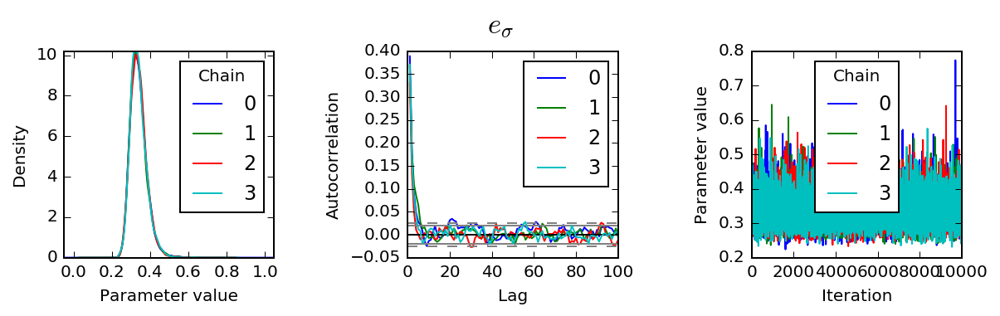

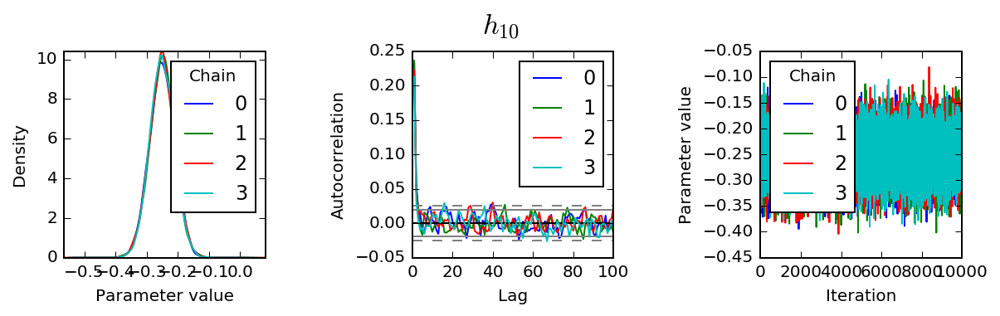

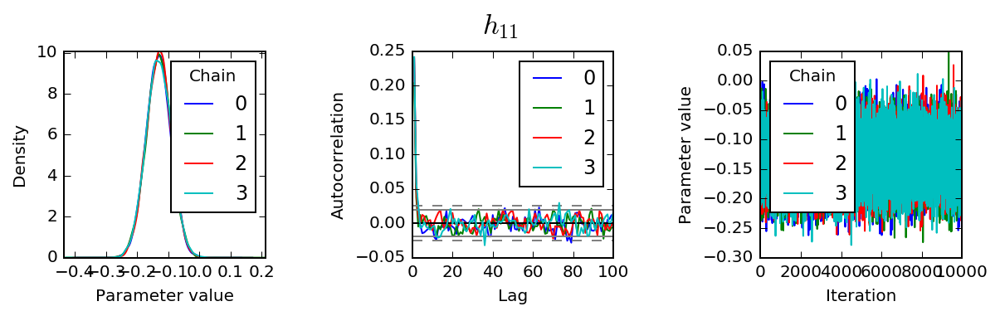

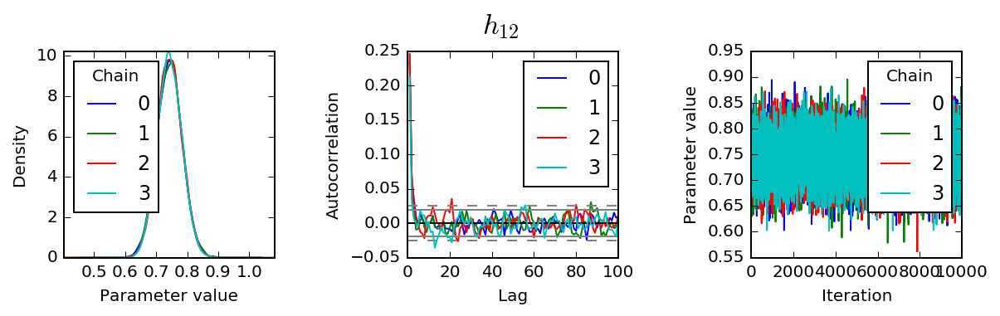

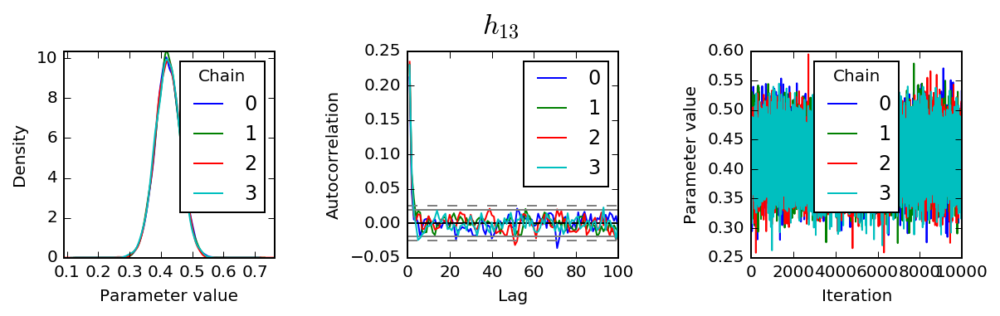

...

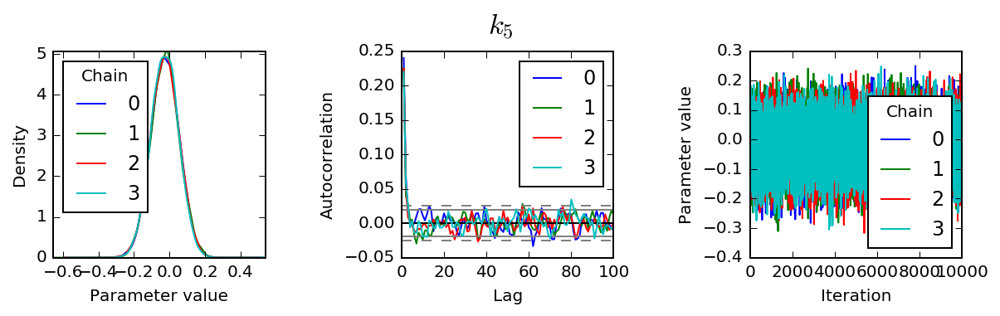

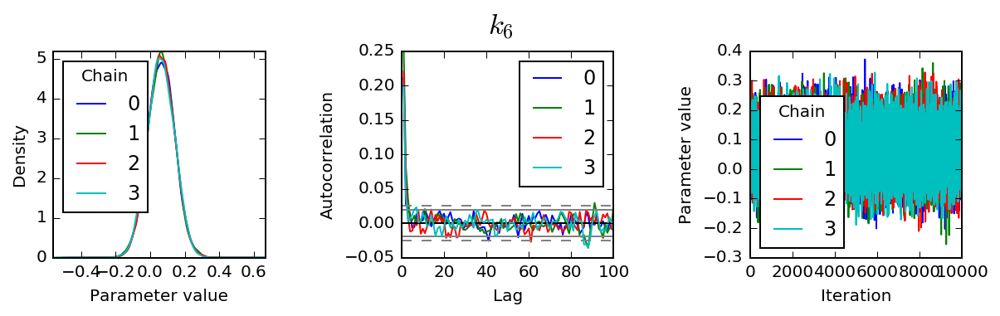

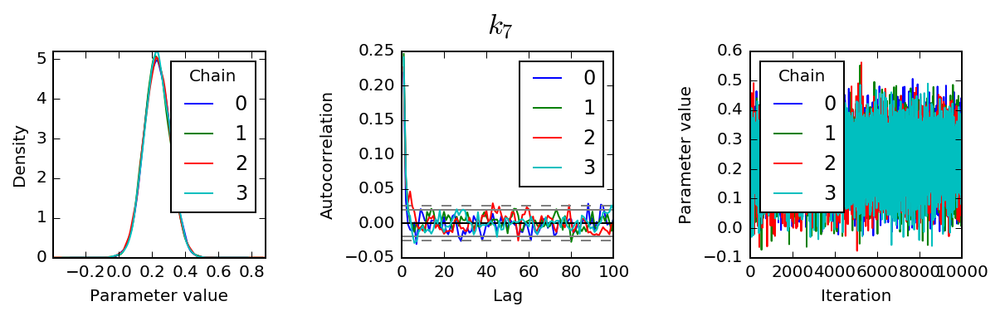

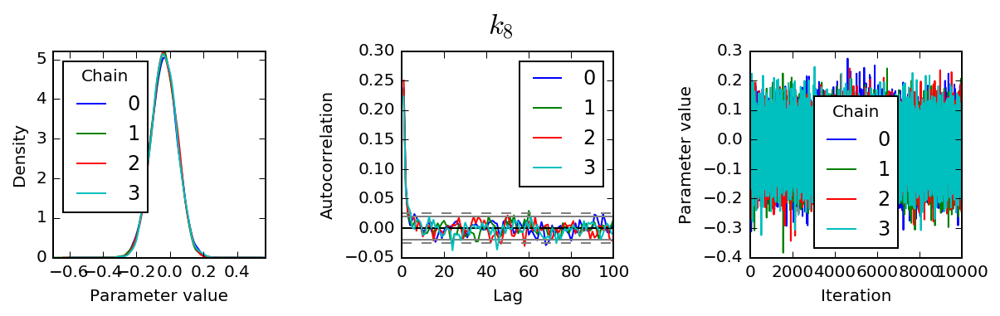

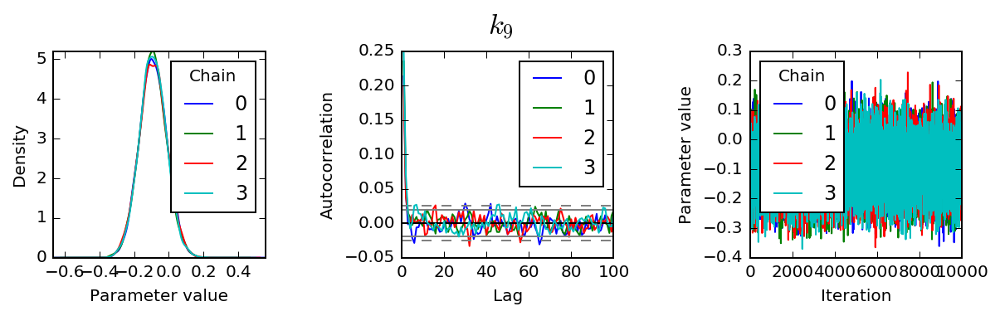

In [20]:
## Use pandas three dimensional Panel to represent the trace:

trace = pd.Panel({k: v for k, v in samples_Nm1.items()})
trace.axes[0].name = 'Variable'
trace.axes[1].name = 'Iteration'
trace.axes[2].name = 'Chain'
 
## Point estimates:
print(trace.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('Nm1_JAGS_h_and_k_'+'{}.png'.format(filename))
 
# Display diagnostic plots
for var in trace:
    plot(trace, var)
 


11.0
$k_{21}$
$h_{21}$
$h_{31}$
$h_{1}$
$h_{11}$
$h_{41}$
$k_{1}$
$k_{11}$
$e_{\sigma}$
$k_{31}$
$k_{41}$


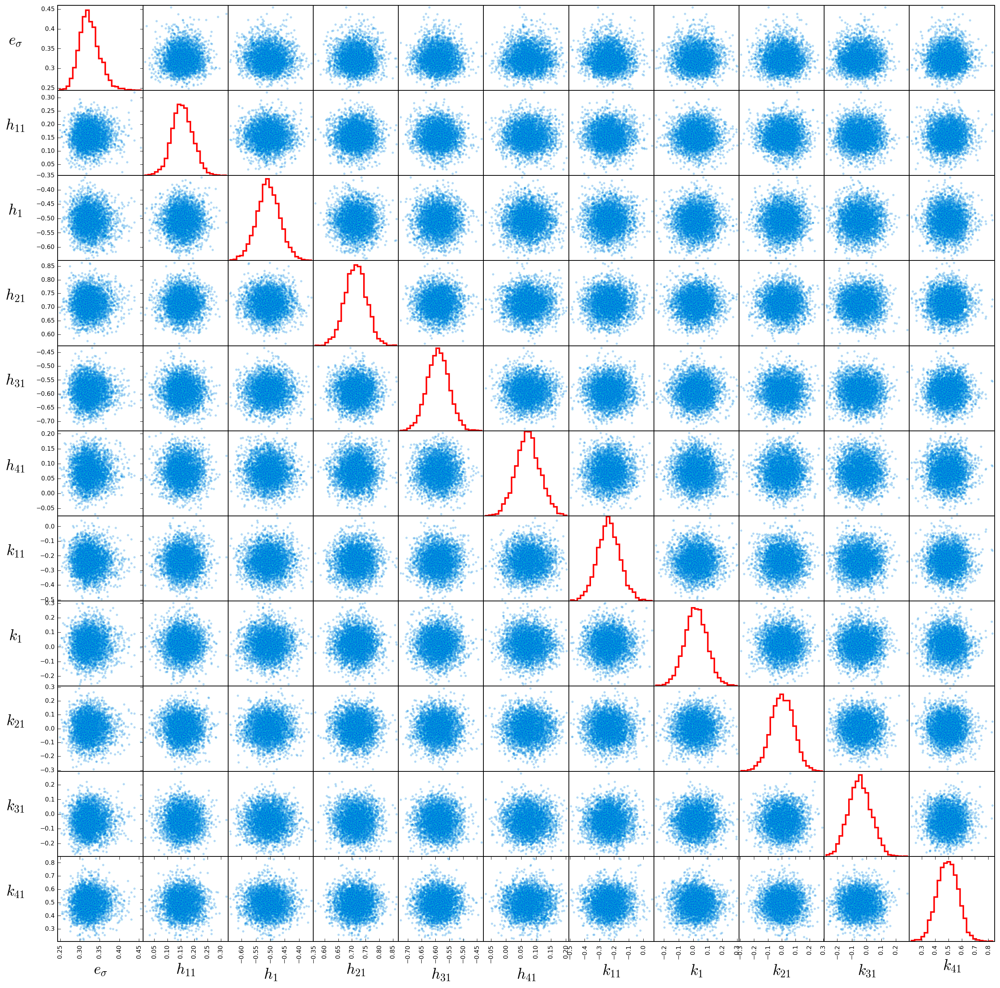

In [54]:
## Scatter matrix plot:

## Redefine the trace so that we only vizualize every 10th latent variable element in 
## the scatter_matrix plot below. Vizualizing all 50 is too cumbersome for the scatter
## matrix. 

samples_Nm1_for_scatter_matrix = {}
Nsamp=25
## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 10
numHyperParams = 1
dim = (Nsamp/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Nsamp,thin):
    samples_Nm1_for_scatter_matrix.update({'$h_{'+str(i+1)+'}$': samples['h'][i,:,:], '$k_{'+str(i+1)+'}$': samples['k'][i,:,:]})
samples_Nm1_for_scatter_matrix.update({'$e_{\sigma}$': samples['e_sigma'].squeeze(0)})

for j, i in samples_Nm1_for_scatter_matrix.items():
    print(j)
#    print(i)

trace_2 = pd.Panel({k: v for k, v in samples_Nm1_for_scatter_matrix.items()})

sm = scatter_matrix(trace_2.to_frame(),  color="darkturquoise", alpha=0.2, figsize=(dim*2, dim*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})
## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]
## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]
## Change label rotation
## This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]
[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]
## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]
## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

plt.savefig('scatter_matrix_Nm1_JAGS.png')


<h3 align="left"> 2. Generalize to a two-component Gaussian Mixture Population Model </h3>

In [10]:
## Below we designate the population values of our two-component truncated Gaussian 
## generative model. These are the truths that we should recover if our hiararchical 
## Bayesian model is properly specified and diagnostics have indicated that the simulation 
## has "not not converged".
Ndata = 50
Nm = 2
frac = [0.7,0.3]
sigmae = [0.05,0.3]

## After generating values from the population model, we now add realistic Gaussian noise 
## to create simulated measurements. 
sigmahobs = 0.04
sigmakobs = 0.08

h = np.repeat(0.,Ndata)
k = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
khat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)
khat_sigma  = np.repeat(sigmakobs,Ndata)

#print(khat_sigma)

for i in range(0,Ndata):
    #print('i')
    #print(i)
    
    c = np.random.choice(len(frac), 1, p=frac, replace=True)
    #print(int(c))
    h[i] = rnorm_bound(1,0,sigmae[int(c)],lower_bound=-1,upper_bound=1)
    # Euler's formula: h^2 + k^2 = 1
    lb = -np.sqrt(1-h[i]**2)
    ub = np.sqrt(1-h[i]**2)
    k[i] = rnorm_bound(1,0,sigmae[int(c)],lower_bound=lb,upper_bound=ub) 
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)
    khat[i] = rnorm_bound(1,k[i],sigmakobs,lower_bound=lb,upper_bound=ub)

    
print(h, hhat, k, khat)

[ 0.04480679 -0.02643924 -0.04673069 -0.01948731  0.05842538 -0.04334208
  0.12262565 -0.02085004  0.32542453  0.08970999 -0.48523874  0.01456828
 -0.06850277 -0.09207462 -0.1423052   0.06652579  0.03258356 -0.25134604
  0.38952598  0.01150507 -0.28996121 -0.00930151 -0.02299844 -0.23733678
  0.03534056 -0.2457059  -0.15393962 -0.02316054  0.43739942 -0.52063463
 -0.00753525  0.36415344  0.11997618 -0.45184277 -0.06776791 -0.22505409
  0.01847575  0.10539107 -0.10569378 -0.05867995  0.01878503  0.33459848
  0.0257153   0.25455749  0.03947602 -0.00593605 -0.04583873 -0.00941074
  0.0336548  -0.11365012] [  7.31290999e-02   3.01661502e-02  -3.06755507e-02  -8.07509778e-02
   7.51309263e-02  -6.27846786e-02   1.23991465e-01  -2.08401992e-02
   3.60462191e-01   1.20004386e-01  -4.99627609e-01  -3.63065542e-04
  -8.25914299e-02  -1.31861458e-01  -1.13093338e-01   1.16081489e-01
  -1.33235699e-02  -2.21640523e-01   3.61224405e-01   3.68433217e-02
  -2.71305100e-01   3.37235169e-02   4.240002

In [65]:
# JAGS model code

code = '''

model {
        
    #Population parameters
    for (j in 1:Nm) {
        e_sigma[j] ~ dunif(0.0, 1.0)
        e_phi[j] <- 1/(e_sigma[j]*e_sigma[j])
        a[j] <- 1;
    }

    f ~ ddirch(a[])
        
    for (n in 1:Ndata){
    
        #True planet properties
        c[n] ~ dcat(f[]) 
        h[n] ~ dnorm(0, e_phi[c[n]]) T(-1,1) #Can try multivariate truncated normal in future
        k[n] ~ dnorm(0, e_phi[c[n]]) T(-sqrt(1-h[n]*h[n]),sqrt(1-h[n]*h[n]))
            
        #Observed planet properties
        hhat[n] ~ dnorm(h[n], 1.0/(hhat_sigma[n]*hhat_sigma[n])) T(-1,1)
        khat[n] ~ dnorm(k[n], 1.0/(khat_sigma[n]*khat_sigma[n])) T(-sqrt(1-hhat[n]*hhat[n]),sqrt(1-hhat[n]*hhat[n]))
    }
        
}
'''

In [89]:
# Load additional JAGS module
pyjags.load_module('glm')
pyjags.load_module('dic')

#data list include only variables in the model
model = pyjags.Model(code, data=dict(Nm=Nm, Ndata=Ndata, hhat=hhat, khat=khat, 
                                     hhat_sigma=hhat_sigma, khat_sigma=khat_sigma), 
                     chains=4, adapt=1000)
# threads=4, chains_per_thread=1 
# 500 warmup / burn-in iterations, not used for inference.
model.sample(500, vars=[])

## Run model for desired steps, monitoring hyperparameter variables.
## Returns a dictionary with numpy array for each monitored variable.
## Shapes of returned arrays are (... shape of variable ..., iterations, chains).
## 
iters = 1000000
samples2 = model.sample(iters, vars=['e_sigma', 'h', 'k', 'c', 'f'])

# Pickle the data
#with open('ecc_1_test.pkl', 'wb') as handle:
#    pickle.dump(samples, handle)
    
# Retrieve pickled data
# with open('ecc_1_test.pkl', 'rb') as handle:
#      retrieved_results = pickle.load(handle)


adapting: iterations 4000 of 4000, elapsed 0:00:05, remaining 0:00:00
adapting: iterations 4000 of 4000, elapsed 0:00:05, remaining 0:00:00
sampling: iterations 2000 of 2000, elapsed 0:00:02, remaining 0:00:00
sampling: iterations 7596 of 4000000, elapsed 0:00:08, remaining 1:12:29
sampling: iterations 12184 of 4000000, elapsed 0:00:13, remaining 1:13:34
sampling: iterations 16700 of 4000000, elapsed 0:00:19, remaining 1:15:01
sampling: iterations 21124 of 4000000, elapsed 0:00:24, remaining 1:15:33
sampling: iterations 25512 of 4000000, elapsed 0:00:29, remaining 1:16:11
sampling: iterations 29856 of 4000000, elapsed 0:00:35, remaining 1:16:42
sampling: iterations 34168 of 4000000, elapsed 0:00:40, remaining 1:17:17
sampling: iterations 38440 of 4000000, elapsed 0:00:45, remaining 1:17:58
sampling: iterations 46928 of 4000000, elapsed 0:00:55, remaining 1:17:12
sampling: iterations 55460 of 4000000, elapsed 0:01:05, remaining 1:17:23
sampling: iterations 63968 of 4000000, elapsed 0:01

Sort the high and low mixture components to accomidate the exchangeability of parameters

0.00128720151553


([array([   2.,   11.,   23.,   44.,   75.,  144.,  190.,  248.,  190.,   73.]),
  array([   0.,    5.,   21.,   33.,   75.,  135.,  214.,  232.,  217.,   68.]),
  array([   3.,    6.,   17.,   41.,   94.,  142.,  213.,  205.,  186.,   93.]),
  array([   0.,   12.,   19.,   48.,  118.,  185.,  222.,  187.,  163.,   46.])],
 array([ 0.25354044,  0.32805768,  0.40257491,  0.47709215,  0.55160938,
         0.62612662,  0.70064386,  0.77516109,  0.84967833,  0.92419556,
         0.9987128 ]),
 <a list of 4 Lists of Patches objects>)

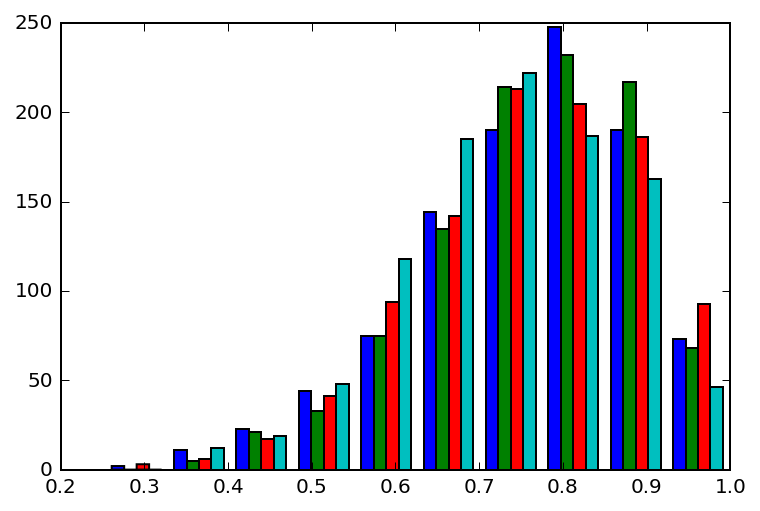

In [105]:
chain_thin = 100
start = int(iters-1000)
esigma_low = np.where(samples2['e_sigma'][0,start::,:] <= samples2['e_sigma'][1,start::,:], samples2['e_sigma'][0,start::,:], samples2['e_sigma'][1,start::,:])
esigma_hi = np.where(samples2['e_sigma'][0,start::,:] > samples2['e_sigma'][1,start::,:], samples2['e_sigma'][0,start::,:], samples2['e_sigma'][1,start::,:])
f_low = np.where(samples2['e_sigma'][0,start::,:] <= samples2['e_sigma'][1,start::,:], samples2['f'][0,start::,:], samples2['f'][1,start::,:])
f_hi = np.where(samples2['e_sigma'][0,start::,:] > samples2['e_sigma'][1,start::,:], samples2['f'][0,start::,:], samples2['f'][1,start::,:])
print(np.min(f_hi))
plt.hist(f_low)

In [106]:
iters = 1000000

#print(samples)
#print(samples.items())

print(samples2['h'].shape)
print(samples2['k'][0,start::,:].shape)
print('-----')
samples_Nm2 = {}
Nsamp=50
thin = 1
numHyperParams = 4
dim = (Nsamp/thin)*2 + numHyperParams
print(dim)
for i in np.arange(0,Nsamp,thin):
    samples_Nm2.update({'$h_{'+str(i+1)+'}$': samples2['h'][i,start::,:], '$k_{'+str(i+1)+'}$': samples2['k'][i,start::,:]})
samples_Nm2.update({'$e_{\sigma_{low}}$': esigma_low, '$e_{\sigma_{high}}$': esigma_hi })
samples_Nm2.update({'$f_{low}$': f_low,'$f_{high}$': f_hi })

for j, i in samples_Nm2.items():
    print(j)
    #print(i)


(50, 1000000, 4)
(1000, 4)
-----
104.0
$h_{2}$
$k_{6}$
$k_{17}$
$h_{14}$
$k_{38}$
$h_{31}$
$k_{8}$
$k_{39}$
$k_{42}$
$k_{32}$
$h_{19}$
$k_{11}$
$h_{29}$
$k_{23}$
$h_{16}$
$k_{4}$
$h_{10}$
$h_{33}$
$k_{46}$
$f_{high}$
$k_{35}$
$h_{41}$
$k_{15}$
$k_{18}$
$h_{25}$
$h_{39}$
$k_{21}$
$e_{\sigma_{low}}$
$h_{20}$
$h_{22}$
$h_{46}$
$k_{19}$
$h_{13}$
$h_{9}$
$k_{1}$
$k_{50}$
$k_{3}$
$e_{\sigma_{high}}$
$k_{30}$
$h_{45}$
$h_{4}$
$h_{37}$
$h_{6}$
$h_{35}$
$h_{30}$
$h_{47}$
$k_{48}$
$k_{40}$
$k_{27}$
$k_{28}$
$k_{25}$
$k_{13}$
$h_{42}$
$k_{47}$
$h_{32}$
$h_{3}$
$k_{16}$
$k_{14}$
$h_{15}$
$h_{17}$
$h_{5}$
$k_{24}$
$f_{low}$
$h_{18}$
$h_{34}$
$h_{49}$
$k_{22}$
$h_{43}$
$k_{9}$
$h_{28}$
$h_{24}$
$h_{26}$
$h_{1}$
$h_{11}$
$k_{20}$
$h_{48}$
$k_{33}$
$k_{5}$
$k_{34}$
$k_{7}$
$k_{36}$
$h_{21}$
$h_{12}$
$h_{8}$
$k_{29}$
$h_{40}$
$k_{37}$
$k_{49}$
$h_{27}$
$k_{31}$
$k_{2}$
$k_{12}$
$k_{10}$
$h_{7}$
$k_{44}$
$h_{44}$
$k_{45}$
$h_{38}$
$h_{50}$
$k_{26}$
$k_{41}$
$h_{23}$
$k_{43}$
$h_{36}$


In [107]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm2:
    summary(samples_Nm2, varname)


$h_{2}$ mean =   0.1, 95% credible interval [ 0.1  0.1]
$k_{6}$ mean =   0.0, 95% credible interval [-0.0  0.1]
$k_{17}$ mean =  -0.1, 95% credible interval [-0.1  0.0]
$h_{14}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{38}$ mean =  -0.0, 95% credible interval [-0.1  0.1]
$h_{31}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$k_{8}$ mean =   0.0, 95% credible interval [ 0.0  0.1]
$k_{39}$ mean =  -0.1, 95% credible interval [-0.2  0.0]
$k_{42}$ mean =   0.0, 95% credible interval [-0.0  0.1]
$k_{32}$ mean =   0.0, 95% credible interval [-0.0  0.1]
$h_{19}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{11}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{29}$ mean =  -0.0, 95% credible interval [-0.0  0.0]
$k_{23}$ mean =   0.1, 95% credible interval [ 0.0  0.3]
$h_{16}$ mean =   0.0, 95% credible interval [-0.0  0.1]
$k_{4}$ mean =  -0.0, 95% credible interval [-0.1 -0.0]
$h_{10}$ mean =   0.0, 95% credible interval [-0.0  0.0]
$h_{33}$ mean =   0.1, 95% credible

Variable
$e_{\sigma_{high}}$    0.298876
$e_{\sigma_{low}}$     0.073295
$f_{high}$             0.245999
$f_{low}$              0.754001
$h_{10}$              -0.013598
$h_{11}$              -0.053020
$h_{12}$              -0.076786
$h_{13}$              -0.070821
$h_{14}$              -0.003734
$h_{15}$              -0.072584
$h_{16}$               0.030121
$h_{17}$              -0.063424
$h_{18}$              -0.006216
$h_{19}$              -0.016505
$h_{1}$                0.036280
$h_{20}$              -0.170053
$h_{21}$              -0.141216
$h_{22}$               0.240777
$h_{23}$              -0.163245
$h_{24}$              -0.033681
$h_{25}$               0.026705
$h_{26}$               0.020277
$h_{27}$              -0.074200
$h_{28}$              -0.115503
$h_{29}$               0.000819
$h_{2}$                0.067883
$h_{30}$               0.371392
$h_{31}$               0.058485
$h_{32}$               0.011967
$h_{33}$               0.086946
                         ...   

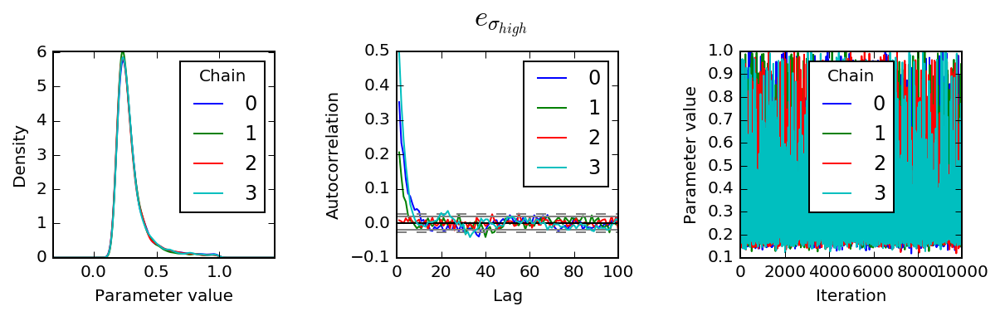

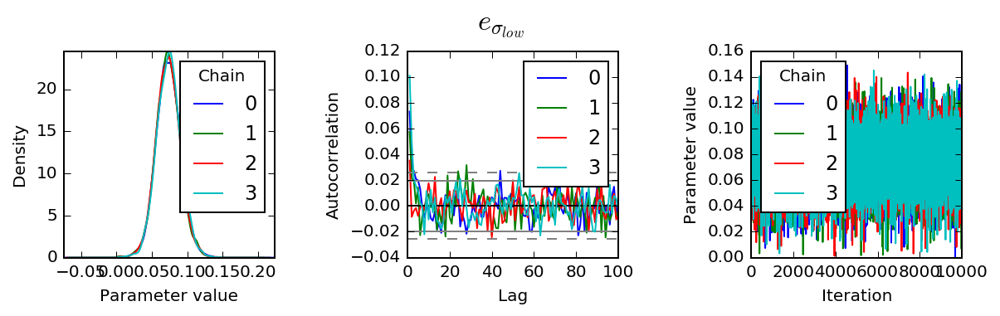

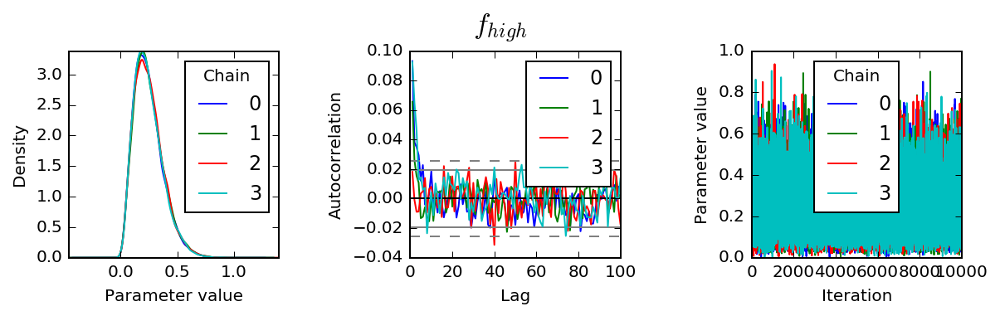

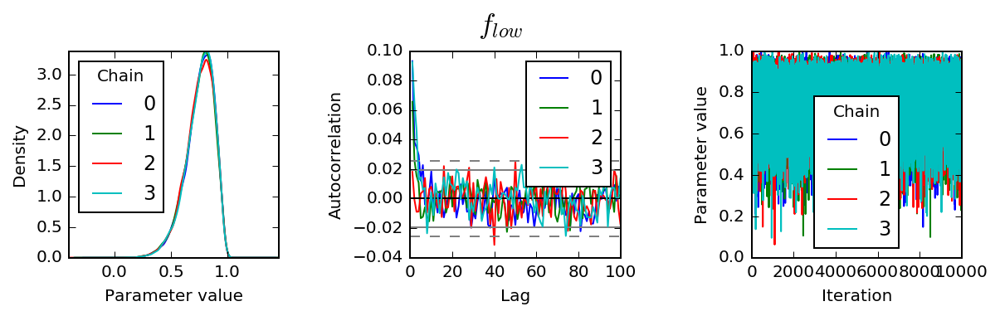

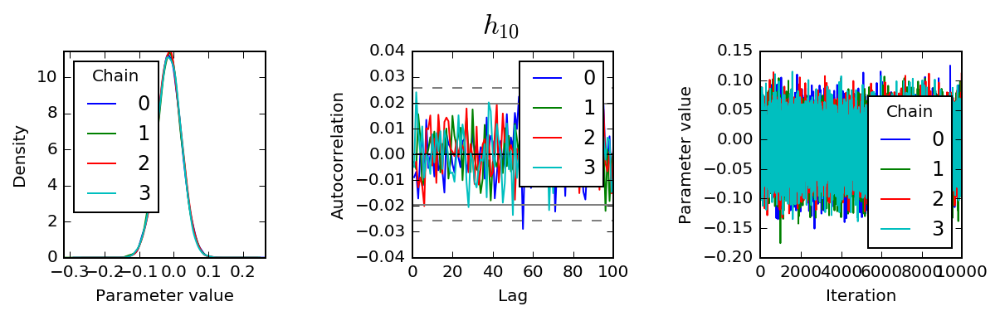

...

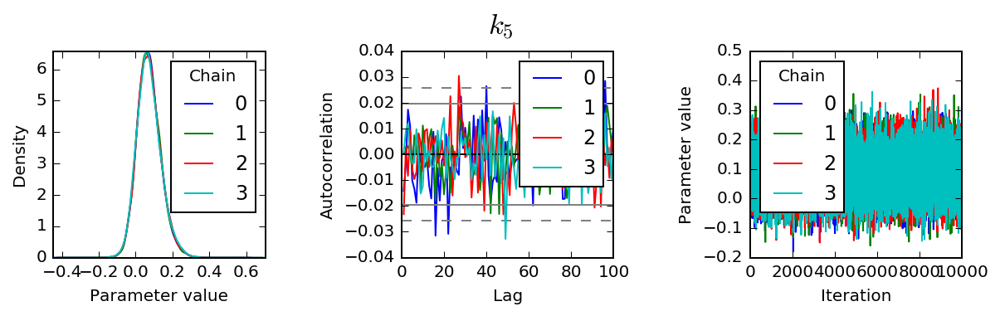

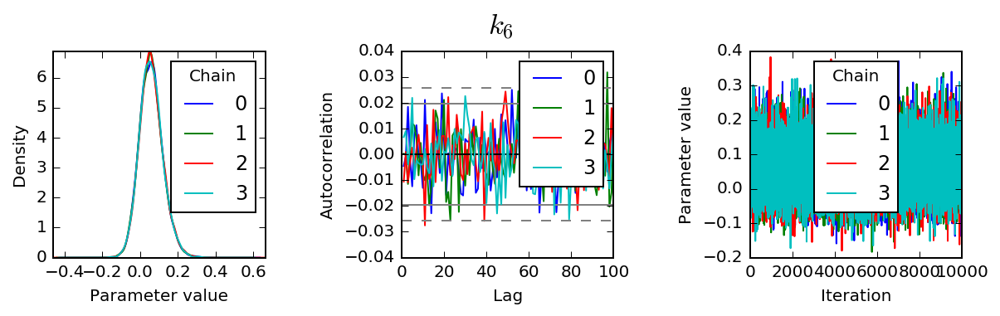

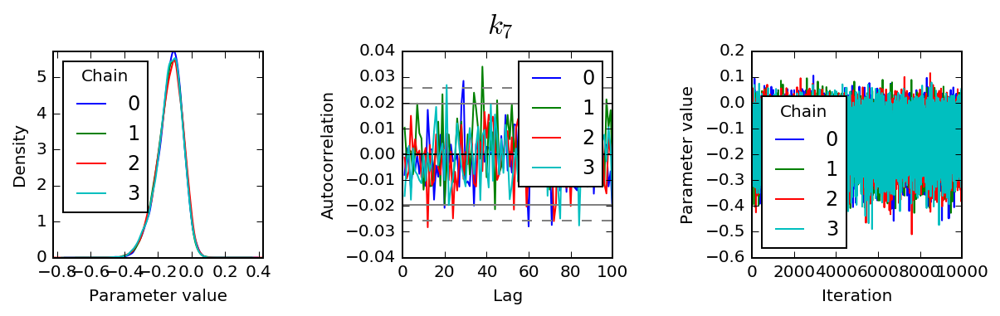

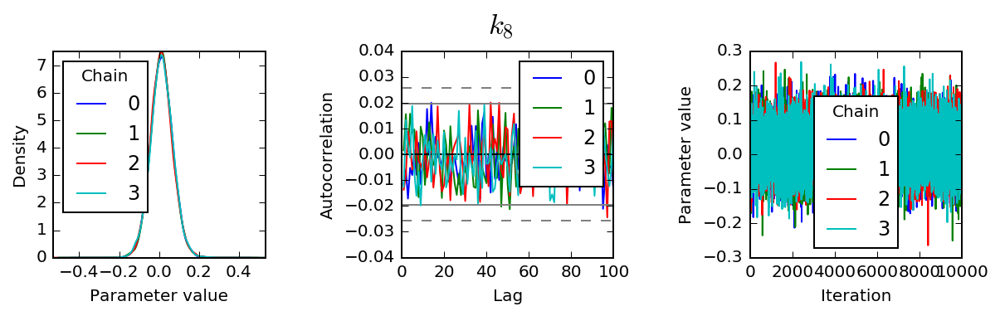

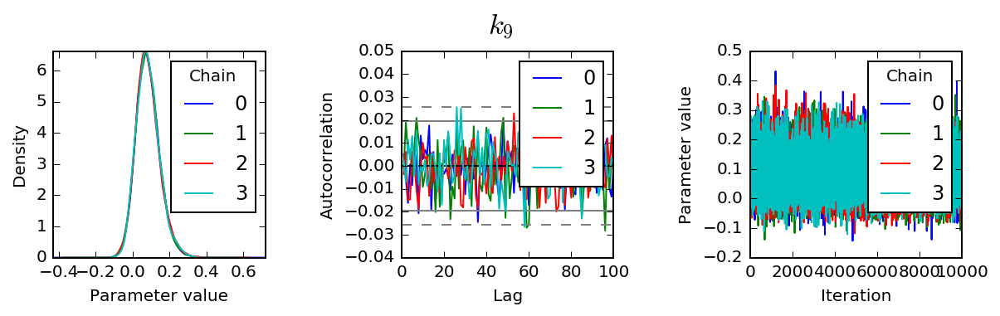

In [100]:
## Use pandas three dimensional Panel to represent the trace:

trace = pd.Panel({k: v for k, v in samples_Nm2.items()})
trace.axes[0].name = 'Variable'
trace.axes[1].name = 'Iteration'
trace.axes[2].name = 'Chain'
 
## Point estimates:
print(trace.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("/", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('Nm2_JAGS_'+'{}.png'.format(filename))

    
## Display diagnostic plots
for var in trace:
    plot(trace, var)
 


14.0
$k_{21}$
$h_{21}$
$e_{\sigma_{low}}$
$h_{31}$
$h_{1}$
$h_{11}$
$f_{low}$
$h_{41}$
$f_{high}$
$k_{1}$
$k_{11}$
$k_{31}$
$k_{41}$
$e_{\sigma_{high}}$


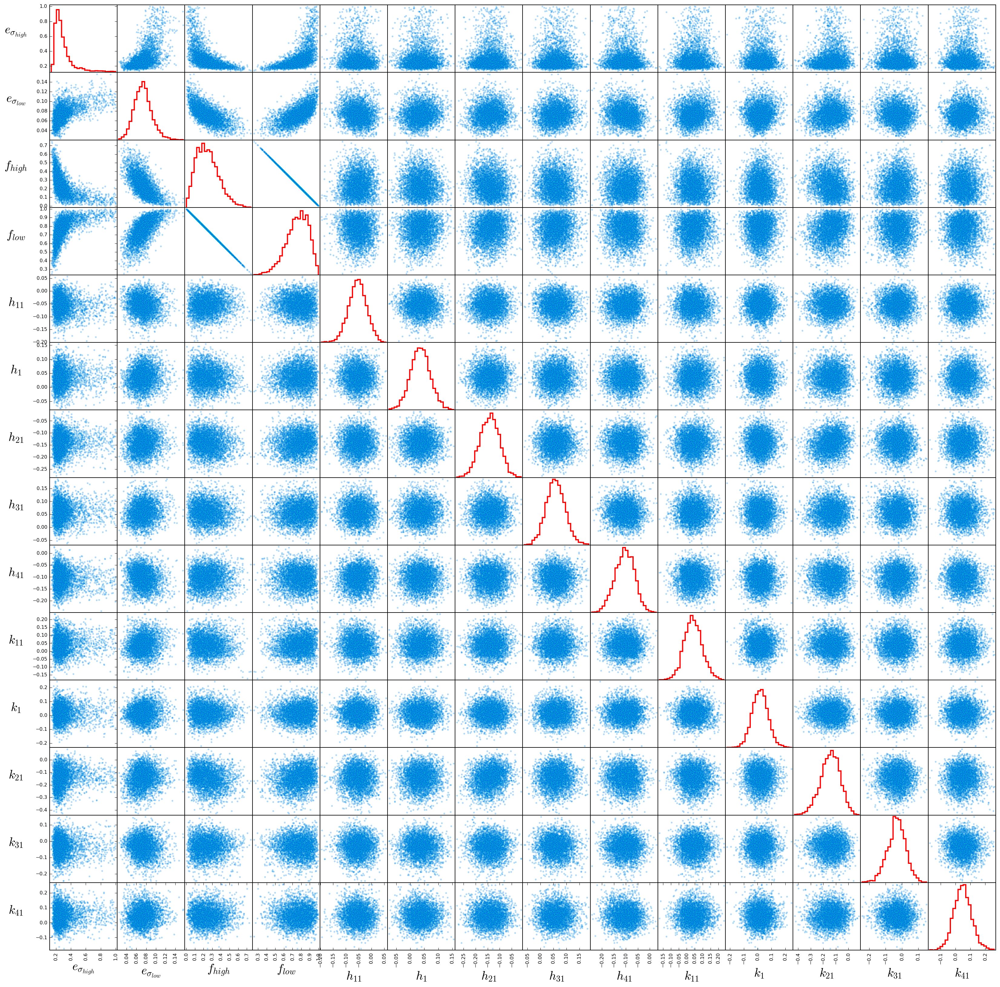

In [108]:
## Scatter matrix plot:

## Redefine the trace so that we only vizualize every 10th latent variable element in 
## the scatter_matrix plot below. Vizualizing all 50 is too cumbersome for the scatter
## matrix. 

samples_Nm2_for_scatter_matrix = {}

## adjust the thin varible to only look at every 10th population element by setting it to 10
thin = 10
numHyperParams = 4
dim = (Ndata/thin)*2 + numHyperParams
print(dim)

for i in np.arange(0,Ndata,thin):
    samples_Nm2_for_scatter_matrix.update({'$h_{'+str(i+1)+'}$': samples2['h'][i,start::,:], '$k_{'+str(i+1)+'}$': samples2['k'][i,start::,:]})
samples_Nm2_for_scatter_matrix.update({'$e_{\sigma_{low}}$': esigma_low, '$e_{\sigma_{high}}$': esigma_hi })
samples_Nm2_for_scatter_matrix.update({'$f_{low}$': f_low,'$f_{high}$': f_hi })

for j, i in samples_Nm2_for_scatter_matrix.items():
    print(j)
#    print(i)

trace_3 = pd.Panel({k: v for k, v in samples_Nm2_for_scatter_matrix.items()})

sm = scatter_matrix(trace_3.to_frame(),  color="darkturquoise", alpha=0.2, figsize=(dim*2, dim*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})
## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]
## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]
## Change label rotation
## This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]
[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]
## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]
## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

plt.savefig('scatter_matrix_Nm2_JAGS.png')
